***
# Epileptic Seizure Recognition Data Set
***

***
Source: https://archive.ics.uci.edu/ml/datasets/Epileptic+Seizure+Recognition
***

Data Set Information:

Attribute Information:

The original dataset from the reference consists of 5 different folders, each with 100 files, with each file representing a single subject/person. Each file is a recording of brain activity for 23.6 seconds. The corresponding time-series is sampled into 4097 data points. Each data point is the value of the EEG recording at a different point in time. So we have total 500 individuals with each has 4097 data points for 23.5 seconds.

We divided and shuffled every 4097 data points into 23 chunks, each chunk contains 178 data points for 1 second, and each data point is the value of the EEG recording at a different point in time. So now we have 23 x 500 = 11500 pieces of information(row), each information contains 178 data points for 1 second(column), the last column represents the label y {1,2,3,4,5}.

The response variable is y in column 179, the Explanatory variables X1, X2, ..., X178

y contains the category of the 178-dimensional input vector. Specifically y in {1, 2, 3, 4, 5}:

5 - eyes open, means when they were recording the EEG signal of the brain the patient had their eyes open

4 - eyes closed, means when they were recording the EEG signal the patient had their eyes closed

3 - Yes they identify where the region of the tumor was in the brain and recording the EEG activity from the healthy brain area

2 - They recorder the EEG from the area where the tumor was located

1 - Recording of seizure activity

All subjects falling in classes 2, 3, 4, and 5 are subjects who did not have epileptic seizure. Only subjects in class 1 have epileptic seizure. Our motivation for creating this version of the data was to simplify access to the data via the creation of a .csv version of it. 

**Although there are 5 classes most authors have done binary classification, namely class 1 (Epileptic seizure) against the rest.**

Relevant Papers:

Andrzejak RG, Lehnertz K, Rieke C, Mormann F, David P, Elger CE (2001) Indications of nonlinear deterministic and finite dimensional structures in time series of brain electrical activity: Dependence on recording region and brain state, Phys. Rev. E, 64, 061907

***
# Challenge and Approaches
***


    1. Apply dimensionality reduction techniques to visualize the observations.
    2. Apply clustering techniques to group similar observations.

Here, we will explore two different dimensionality reduction techniques, namely PCA and UMAP. The objective is to try to clearly define each of the 5 separate ground truths, although a clear identification of the seizure cluster (target = 1) is a primary goal. The exact approach will depend on the outcomes of the data reduction steps through visualization. For both data reduction techniques we will proceed to apply several clustering algorithms to the reduced data. These will include K-means, hierarchical (agglomerative), and Gaussian Mixture clustering models.</br>

***
# Import Libraries / Setup Environment
***

In [51]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import seaborn as sns
sns.set_style('whitegrid')
import matplotlib.pyplot as plt
import time
import missingno as msno

from sklearn.decomposition import PCA
from sklearn.metrics import adjusted_rand_score, silhouette_score
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
import umap
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.neighbors import NearestNeighbors

***
# Load and Scale Data
***

Dimensionality reduction techniques are sensitive to scale. So we will load and scale are data before applying any data reductions

In [52]:
df = pd.read_csv('epilespy.csv')
df.head()

,Unnamed: 0,X1,X2,X3,X4,X5,X6,X7,X8,X9,...,X170,X171,X172,X173,X174,X175,X176,X177,X178,y
0,X21.V1.791,135,190,229,223,192,125,55,-9,-33,...,-17,-15,-31,-77,-103,-127,-116,-83,-51,4
1,X15.V1.924,386,382,356,331,320,315,307,272,244,...,164,150,146,152,157,156,154,143,129,1
2,X8.V1.1,-32,-39,-47,-37,-32,-36,-57,-73,-85,...,57,64,48,19,-12,-30,-35,-35,-36,5
3,X16.V1.60,-105,-101,-96,-92,-89,-95,-102,-100,-87,...,-82,-81,-80,-77,-85,-77,-72,-69,-65,5
4,X20.V1.54,-9,-65,-98,-102,-78,-48,-16,0,-21,...,4,2,-12,-32,-41,-65,-83,-89,-73,5


In [53]:
df = df.drop(columns = 'Unnamed: 0')
## create ground truth label and drop that data from feature space
y = df['y']
df = df.drop(columns = 'y')

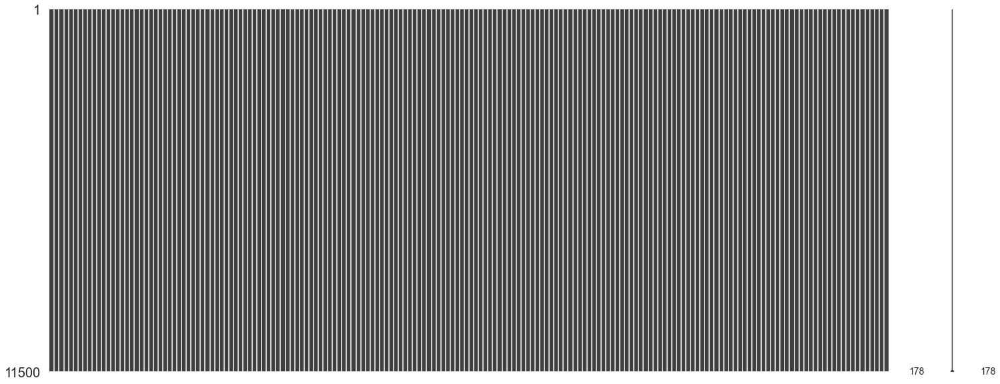

In [54]:
msno.matrix(df) # demonstrates full complement of data, no missing values

In [55]:
df.head()

,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,...,X169,X170,X171,X172,X173,X174,X175,X176,X177,X178
0,135,190,229,223,192,125,55,-9,-33,-38,...,8,-17,-15,-31,-77,-103,-127,-116,-83,-51
1,386,382,356,331,320,315,307,272,244,232,...,168,164,150,146,152,157,156,154,143,129
2,-32,-39,-47,-37,-32,-36,-57,-73,-85,-94,...,29,57,64,48,19,-12,-30,-35,-35,-36
3,-105,-101,-96,-92,-89,-95,-102,-100,-87,-79,...,-80,-82,-81,-80,-77,-85,-77,-72,-69,-65
4,-9,-65,-98,-102,-78,-48,-16,0,-21,-59,...,10,4,2,-12,-32,-41,-65,-83,-89,-73


In [56]:
y.head()

0    4
1    1
2    5
3    5
4    5
Name: y, dtype: int64

In [57]:
# scale data
df = pd.DataFrame(StandardScaler().fit_transform(df),columns = df.columns)
df.shape

(11500, 178)

In [58]:
df.head()

,X1,X2,X3,X4,X5,X6,X7,X8,X9,X10,...,X169,X170,X171,X172,X173,X174,X175,X176,X177,X178
0,0.885051,1.209929,1.462764,1.439539,1.242366,0.818262,0.380910,-0.014267,-0.163196,-0.198415,...,0.105907,-0.041630,-0.020282,-0.107131,-0.375743,-0.535944,-0.693858,-0.634144,-0.433290,-0.235399
1,2.400577,2.366190,2.239441,2.109257,2.037441,1.996033,1.941660,1.719102,1.546403,1.484569,...,1.074264,1.057700,0.972841,0.943023,0.982911,1.018615,1.029295,1.023429,0.954241,0.856537
2,-0.123287,-0.169154,-0.225131,-0.172743,-0.149016,-0.179743,-0.312756,-0.409056,-0.484131,-0.547478,...,0.233004,0.407820,0.455214,0.361582,0.193824,0.008151,-0.103237,-0.136872,-0.138593,-0.144405
3,-0.564057,-0.542530,-0.524794,-0.513803,-0.503073,-0.545472,-0.591462,-0.575607,-0.496475,-0.453979,...,-0.426689,-0.436417,-0.417531,-0.397851,-0.375743,-0.428321,-0.389414,-0.364021,-0.347337,-0.320328
4,0.015586,-0.325731,-0.537025,-0.575814,-0.434746,-0.254129,-0.058825,0.041250,-0.089134,-0.329314,...,0.118012,0.085916,0.082040,0.005598,-0.108758,-0.165242,-0.316347,-0.431551,-0.470127,-0.368858


In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11500 entries, 0 to 11499
Columns: 178 entries, X1 to X178
dtypes: float64(178)
memory usage: 15.6 MB


Let's look at the distribution of labels (y)

Text(0, 0.5, 'Count')

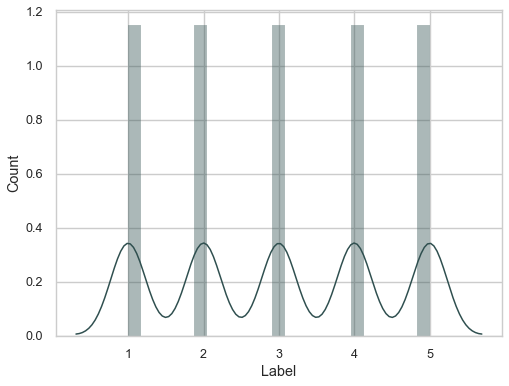

In [66]:
plt.figure(figsize=(8,6))
sns.distplot(y, color = 'darkslategrey')
plt.xlabel('Label')
plt.ylabel('Count')

In [70]:
counts = np.bincount(y)
for ii in range(1,6):
    print('Counts for label {}: {}'.format(ii, counts[ii]))

Counts for label 1: 2300
Counts for label 2: 2300
Counts for label 3: 2300
Counts for label 4: 2300
Counts for label 5: 2300


Text(0.5, 1.0, 'EGG Trace Examples for Each Class')

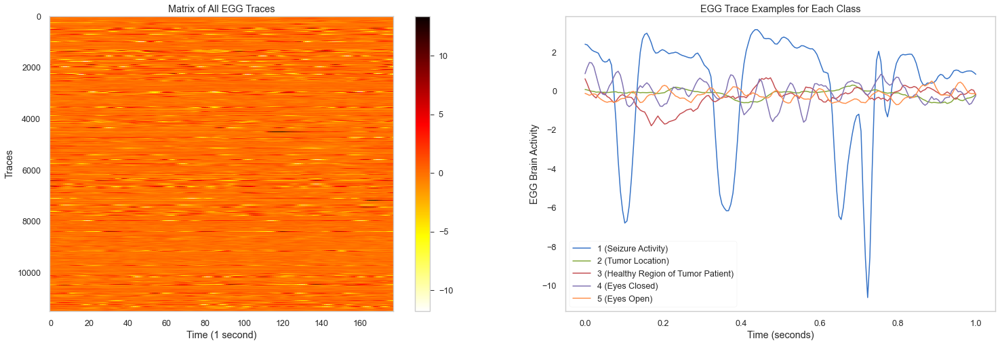

In [63]:
t   = np.linspace(0,1,df.shape[1])

plt.figure(figsize=(25,8))
plt.subplot(121)
plt.imshow(df.to_numpy(), interpolation='nearest', aspect='auto', cmap = 'hot_r')
plt.grid(None)
plt.xlabel('Time (1 second)')
plt.ylabel('Traces')
plt.colorbar()
plt.title('Matrix of All EGG Traces')

plt.subplot(122)
plt.plot(t, df.iloc[list(y).index(1)], label='1 (Seizure Activity)')
plt.plot(t, df.iloc[list(y).index(2)], label='2 (Tumor Location)')
plt.plot(t, df.iloc[list(y).index(3)], label='3 (Healthy Region of Tumor Patient)')
plt.plot(t, df.iloc[list(y).index(4)], label='4 (Eyes Closed)')
plt.plot(t, df.iloc[list(y).index(5)], label='5 (Eyes Open)')
plt.legend()
plt.grid(None)
plt.xlabel('Time (seconds)')
plt.ylabel('EGG Brain Activity')
plt.title('EGG Trace Examples for Each Class')

***
# Dimensionality Reduction and Clustering
***

First, we will define a couple of helper functions that will be used to plot the ground truth color-coded string plots for both the PCA- and UMAP-reduced data. 

In [10]:
## PCA plotter
def gt_plotter_pca(data, predictions, groundtruths):
    # Plot color-coded (ground truth) string-labeled (class assignment) data
    plt.figure(figsize=(5,5))
    colors = 'rbgkc'
    for ii in range(data.shape[0]):
        plt.text(data[ii,0], data[ii,1], str(predictions[ii]), color = colors[groundtruths[ii]], fontdict={'weight':'bold','size':150})
        plt.xticks([])
        plt.yticks([])
        plt.axis('off')

    plt.text(20, 30,   'Ground Truth: 0 (no seizure activity)', color = 'r', fontdict={'weight':'bold','size':300})
    plt.text(20, 28.5, 'Ground Truth: 1 (seizure activity)', color = 'b', fontdict={'weight':'bold','size':300});
    
def gt_plotter_umap(data, predictions, groundtruths):
    plt.figure(figsize=(2,2))
    colors = 'rbgkc'
    for ii in range(data.shape[0]):
        plt.text(data[ii,0], data[ii,1], str(predictions[ii]), color = colors[groundtruths[ii]], fontdict={'weight':'bold','size':10})
        plt.xticks([])
        plt.yticks([])
        plt.axis('off')
    
    plt.text(2, 8,    'Ground Truth: 0 (no seizure activity)', color = 'r', fontdict={'weight':'bold','size':20})
    plt.text(2, 7.75, 'Ground Truth: 1 (seizure activity)', color = 'b', fontdict={'weight':'bold','size':20})
    plt.text(2, 7.5,  'Ground Truth: 2 (eyes closed)', color = 'g', fontdict={'weight':'bold','size':20})

***
## Principal Component Analysis (PCA)
***

**Overview:** Here we will first aply PCA reduce our data to two dimensions and plot the color-coded outcome. Based on the observations, we will apply several clustering algorithms and assess their performance using the silhouette score and known ground truth (adjusted Rand index).
***

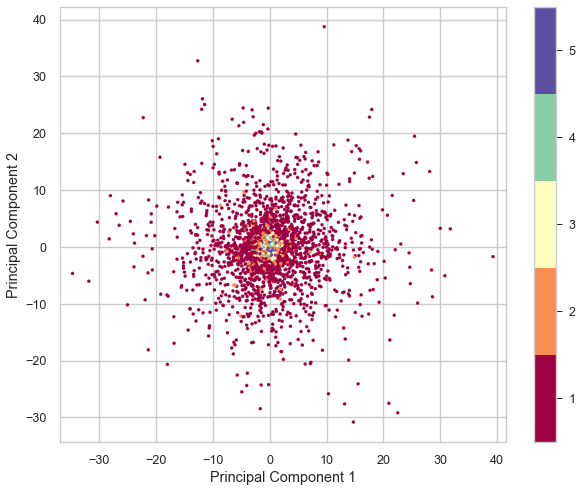

In [12]:
pca = PCA(n_components = 2, svd_solver = 'full')
pcs = pca.fit_transform(df)

def scatterplotter(data, y): # scatter plot helper function
    plt.figure(figsize=(10,8))
    plt.scatter(data[:,0], data[:,1], c = y, cmap = 'Spectral', s = 10)
    plt.gca().set_aspect('equal', 'datalim')
    plt.colorbar(boundaries=np.arange(1,y.nunique()+2)-0.5).set_ticks(np.arange(10))
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')

scatterplotter(pcs, y)

In the next sections we will take our PCA-reduced data and apply an array of clustering techniques (K-means, DBSCAN, Gaussian Mixture Models) evaluating performance using adjusted Rand index and silhouette scores. Application of PCA resulted in substantial dispersion (and potential resolution) of class 1 (seizure condition) from all other classes, which were poorly resolved.</br>

Hence, we will treat the PCA-reduced data as a two class problem with 0 (4 non-seizure conditions) and 1 (seizure condition) labels.</br>

In [13]:
# Generate binary ground truth
binary_class = True

y_pca = []
if binary_class:
    ## create two class problem
    for ii,jj in enumerate(y):
        if jj>1:
            y_pca.append(0)
        else:
            y_pca.append(1)
    print('y:\t{}'.format(list(y[:20])))
    print('y_pca:\t{}'.format(y_pca[:20]))

y:	[4, 1, 5, 5, 5, 5, 4, 2, 1, 4, 5, 1, 3, 4, 2, 3, 2, 3, 4, 2]
y_pca:	[0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0]


***
### K-Means (PCA)

Text(0, 0.5, 'Inertia')

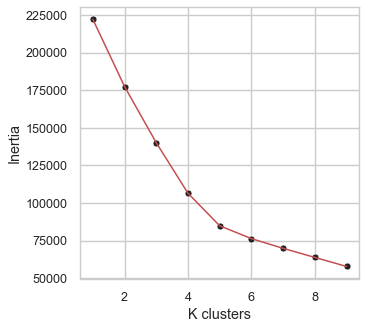

In [14]:
PCA_components = pd.DataFrame(pcs)

plt.figure(figsize = (5,5))
ks = list(range(1,10))
inertias = []

for ii in ks:
    model = KMeans(n_clusters=ii)
    model.fit(PCA_components.iloc[:,:2])
    inertias.append(model.inertia_)

sns.scatterplot(x = ks, y = inertias, color = 'k')
sns.lineplot(x = ks, y = inertias, color = 'r')
plt.xlabel('K clusters')
plt.ylabel('Inertia')

It is interesting to note that the inertia elbow plot is suggesting that 5 clusters would be optimal. However, efforts using all 5 classes previously were unsuccessful (data not shown). We are also treating this as a two-class problem for the PCA-reduced data, so we will go ahead and instantiate the model with two clusters.

In [15]:
kmeans_cluster = KMeans(n_clusters=2, random_state=123, n_jobs=-1, n_init=20)
%timeit kmeans_cluster.fit(PCA_components.iloc[:,:2])
y_pred = kmeans_cluster.predict(PCA_components.iloc[:,:2])

102 ms ± 6.21 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [16]:
silhouette_pca_kmeans = silhouette_score(df, y_pred, metric = 'euclidean')
ari_pca_kmeans = adjusted_rand_score(y_pca, y_pred)
print('Silhouette Score (PCA/Kmeans)    = {:.3f}'.format(silhouette_pca_kmeans))
print('Adjusted Rand Index (PCA/Kmeans) = {:.3f}'.format(ari_pca_kmeans))

Silhouette Score (PCA/Kmeans)    = 0.612
Adjusted Rand Index (PCA/Kmeans) = 0.223


In [17]:
# ground truth plot
gt_plotter_pca(pcs, y_pred, y_pca)

***
### Hierarchical Agglomerative Clustering (PCA)

In [18]:
linkage_lst = ['ward', 'complete', 'average', 'single']
for ii in linkage_lst:
    print('*'*10 + ' Linkage = {} '.format(ii) +10*'*')
    agg_cluster = AgglomerativeClustering(linkage = ii, affinity = 'euclidean', n_clusters = 2)
    clusters = agg_cluster.fit_predict(pcs)
    tmp_ss = silhouette_score(pcs, clusters, metric = 'euclidean')
    tmp_ar = adjusted_rand_score(y_pca, clusters)
    print('Silhouette Score     = {}'.format(tmp_ss))
    print('Adjusted Rand Index  = {}'.format(tmp_ar))

********** Linkage = ward **********
Silhouette Score     = 0.7606761507584167
Adjusted Rand Index  = 0.1649196695350874
********** Linkage = complete **********
Silhouette Score     = 0.7462169636313379
Adjusted Rand Index  = 0.21444388171510143
********** Linkage = average **********
Silhouette Score     = 0.9095027138370475
Adjusted Rand Index  = 0.0005216370956550606
********** Linkage = single **********
Silhouette Score     = 0.9095027138370475
Adjusted Rand Index  = 0.0005216370956550606


In [19]:
agg_cluster = AgglomerativeClustering(linkage = 'complete', affinity = 'euclidean', n_clusters = 2)
clusters = agg_cluster.fit_predict(pcs)

silhouette_pca_hac = silhouette_score(pcs, clusters, metric = 'euclidean')
ari_pca_hac = adjusted_rand_score(y_pca, clusters)
print('Silhouette Score (PCA/Hierachical)    = {}'.format(silhouette_pca_hac))
print('Adjusted Rand Index (PCA/Hierachical) = {}'.format(ari_pca_hac))

Silhouette Score (PCA/Hierachical)    = 0.7462169636313379
Adjusted Rand Index (PCA/Hierachical) = 0.21444388171510143


In [20]:
# ground truth plot
gt_plotter_pca(pcs, clusters, y_pca)

***
### Gaussian Mixture Model (PCA)

In [21]:
gmm_cluster = GaussianMixture(n_components = 2, random_state = 123, max_iter = 1000) 
clusters = gmm_cluster.fit_predict(pcs)

In [22]:
silhouette_pca_gmm = silhouette_score(pcs, clusters, metric = 'euclidean')
ari_pca_gmm = adjusted_rand_score(y_pca, clusters)
print('Silhouette Score (PCA/GMM)    = {}'.format(silhouette_pca_gmm))
print('Adjusted Rand Index (PCA/GMM) = {}'.format(ari_pca_gmm))

Silhouette Score (PCA/GMM)    = 0.6381815131459865
Adjusted Rand Index (PCA/GMM) = 0.7439543170455697


In [23]:
# ground truth plot
gt_plotter_pca(pcs, clusters, y_pca)

***
## Uniform Manifold Approximation and Projection (UMAP)
***

**Overview:** Here we will first apply UMAP to reduce the data down to two dimensions and plot the color-coded outcome. Based on the observations, we will apply several clustering algorithms and assess their performance using the silhouette score and known ground truth (adjusted Rand index).</br>

First, we will define a scatter plotter function and a umap_func function that will allow us to explore the various parameters that can be passed to the UMAP function (i.e n_neighbors, min_dist, metric)
***

In [24]:
def scatterplotter_umap(data, y, panel, params): # scatter plot helper function
    plt.subplot(2,4,panel)
    plt.scatter(data[:,0], data[:,1], c = y, cmap = 'Spectral', s = 5)
    plt.gca().set_aspect('equal', 'datalim')
    plt.colorbar(boundaries=np.arange(1,y.nunique()+2)-0.5).set_ticks(np.arange(1,6))
    plt.title('metric: ' + params['metric'] + '  min_dist: ' + str(params['min_dist']) + ' n_neighbors: ' + str(params['n_neighbors']))

def umap_func(data, params):
    time_start = time.time()
    umap_results = umap.UMAP(random_state = 123, **params).fit_transform(data)
    time_start = time.time()   
    print('UMAP done! Time elapsed: {} seconds'.format(time.time()-time_start))
    return umap_results


### UMAP Nearest Neighbor Tuning 

Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 20
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 35
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 50
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 75
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 100
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 200
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.3, n_neighbors: 250
UMAP done! Time elapsed: 0.0 seconds


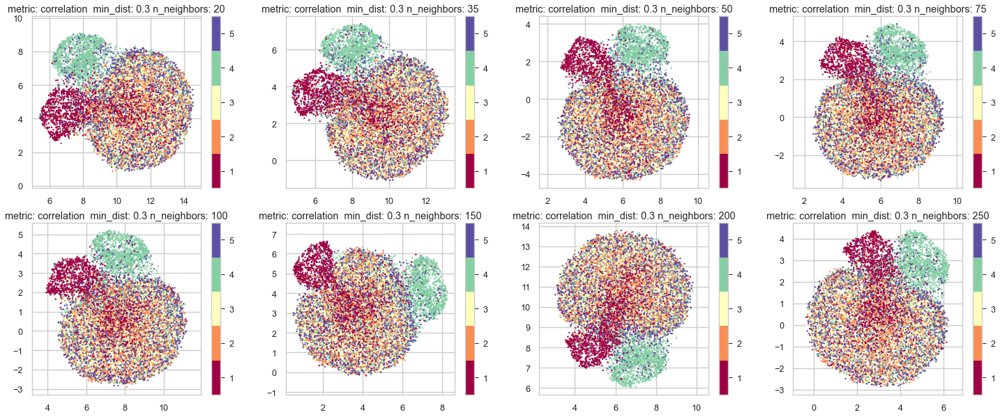

In [25]:
fig = plt.figure(figsize = (25,10))

n_neighbors = [20, 35, 50, 75, 100, 150, 200, 250]

for ii,jj in enumerate(n_neighbors):
    metric = 'correlation'
    min_dist = .3
    print('Running UMAP --> metric: {}, min_dist: {}, n_neighbors: {}'.format(metric, min_dist, jj))
    tmp = umap_func(df, {'metric':metric, 'min_dist':min_dist, 'n_neighbors':jj})
    fig = scatterplotter_umap(tmp, y, ii+1, {'metric':metric, 'min_dist':min_dist, 'n_neighbors':jj})

### UMAP Minimum Distance Tuning

Running UMAP --> metric: correlation, min_dist: 0.1, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.2, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.4, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.5, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.6, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.7, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.8, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.9, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds


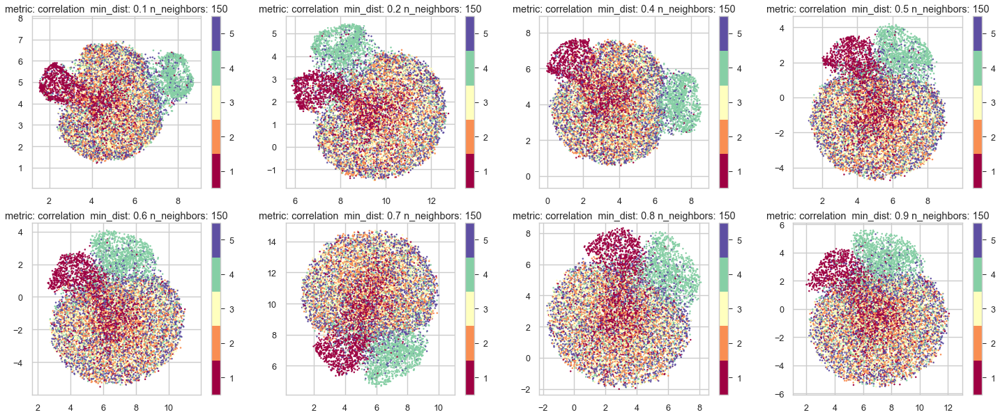

In [26]:
fig = plt.figure(figsize = (25,10))

min_dist = [0.1, 0.2, 0.4, 0.5, 0.6, 0.7, 0.8, .9]

for ii,jj in enumerate(min_dist):
    metric = 'correlation'
    n_neighbors = 150
    print('Running UMAP --> metric: {}, min_dist: {}, n_neighbors: {}'.format(metric, jj, n_neighbors))
    tmp = umap_func(df, {'metric':metric, 'min_dist':jj, 'n_neighbors':n_neighbors})
    fig = scatterplotter_umap(tmp, y, ii+1, {'metric':metric, 'min_dist':jj, 'n_neighbors':n_neighbors})

### UMAP Metric Tuning

Running UMAP --> metric: manhattan, min_dist: 0.1, n_neighbors: 150
UMAP done! Time elapsed: 0.0009989738464355469 seconds
Running UMAP --> metric: euclidean, min_dist: 0.1, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.1, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: correlation, min_dist: 0.1, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds


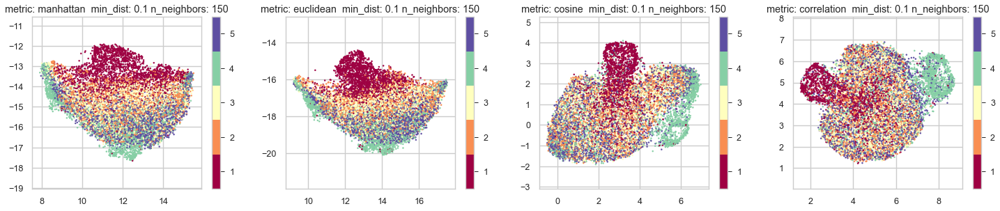

In [27]:
fig = plt.figure(figsize = (25,10))

metric = ['manhattan', 'euclidean', 'cosine', 'correlation']

for ii,jj in enumerate(metric):
    n_neighbors = 150
    min_dist = .1
    print('Running UMAP --> metric: {}, min_dist: {}, n_neighbors: {}'.format(jj, min_dist, n_neighbors))
    tmp = umap_func(df, {'metric':jj, 'min_dist':min_dist, 'n_neighbors':n_neighbors})
    fig = scatterplotter_umap(tmp, y, ii+1, {'metric':jj, 'min_dist':min_dist, 'n_neighbors':n_neighbors})

### UMAP: Check Results Using Cosine Metric

Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 20
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 35
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 50
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 75
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 100
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 150
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 200
UMAP done! Time elapsed: 0.0 seconds
Running UMAP --> metric: cosine, min_dist: 0.2, n_neighbors: 250
UMAP done! Time elapsed: 0.0 seconds


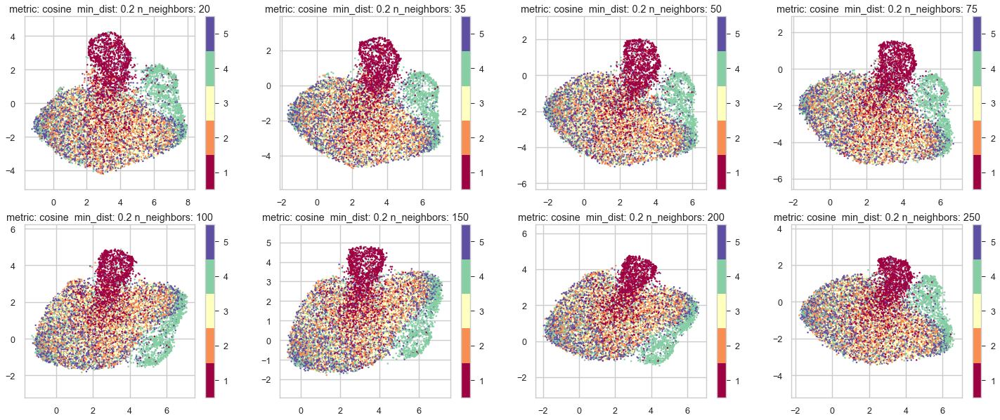

In [28]:
fig = plt.figure(figsize = (25,10))

#n_neighbors = [5, 10, 20, 35, 50, 75, 100, 150]
n_neighbors = [20, 35, 50, 75, 100, 150, 200, 250]
for ii,jj in enumerate(n_neighbors):
    metric = 'cosine'
    min_dist = .2
    print('Running UMAP --> metric: {}, min_dist: {}, n_neighbors: {}'.format(metric, min_dist, jj))
    tmp = umap_func(df, {'metric':metric, 'min_dist':min_dist, 'n_neighbors':jj})
    fig = scatterplotter_umap(tmp, y, ii+1, {'metric':metric, 'min_dist':min_dist, 'n_neighbors':jj})

Using 'metric' set to either correlation or cosine, UMAP with 2 components shows some interesting data in that classes 1 (experiencing seizure throughout the EEG) and 4 (eyes closed throughout the EEG) show some separation that might be advantageous for application of clustering algorithms. We will replot below these using a single color to establish, through eyeballing the data, which metric offers the clearer separation. 

UMAP done! Time elapsed: 0.0 seconds
UMAP done! Time elapsed: 0.0 seconds


Text(0.5, 1.0, 'Metric: cosine')

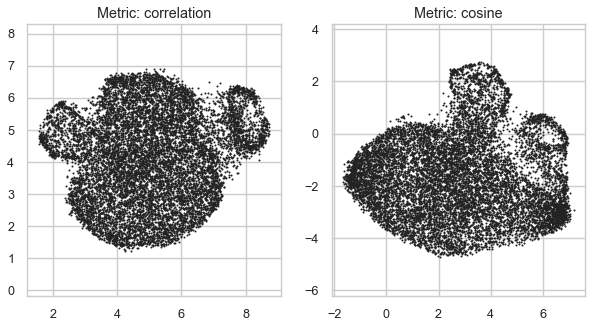

In [29]:
plt.figure(figsize=(10,5))
plt.subplot(121)
tmp = umap_func(df, {'metric':'correlation', 'min_dist':0.1, 'n_neighbors':150})
plt.scatter(tmp[:, 0], tmp[:, 1], color = 'k', s = 3)
plt.gca().set_aspect('equal', 'datalim')
plt.title('Metric: correlation')

plt.subplot(122)
tmp = umap_func(df, {'metric':'cosine', 'min_dist':0.2, 'n_neighbors':35})
plt.scatter(tmp[:, 0], tmp[:, 1], color = 'k', s = 3)
plt.gca().set_aspect('equal', 'datalim')
plt.title('Metric: cosine')

It looks like the correlation metric gives a clearer separation of 2-3 clusters. The enhanced polarization of clusters 1 and 4 might also be beneficial.</br>

Given that the UMAP-reduced data resulted in additional separation of class 1 (seizure condition) and class 4 (eyes closed condition) from all other classes, we will move forward and treat the UMAP-reduced data as a three class problem with 0 (classes 2,3, and 5), 1 (seizure condition), and 2 (eyes open condition) labels.

In [30]:
# create ternary ground truth
ternary_class = True

y_umap = []
if ternary_class:
    ## create two class problem
    for ii,jj in enumerate(y):
        if jj==1:   # seizure condtion
            y_umap.append(1)
        elif jj==4: # eyes closed condition
            y_umap.append(2)
        else:
            y_umap.append(0) # all other conditions
    print('y:\t{}'.format(list(y[:20])))
    print('y_umap:\t{}'.format(y_umap[:20]))

y:	[4, 1, 5, 5, 5, 5, 4, 2, 1, 4, 5, 1, 3, 4, 2, 3, 2, 3, 4, 2]
y_umap:	[2, 1, 0, 0, 0, 0, 2, 0, 1, 2, 0, 1, 0, 2, 0, 0, 0, 0, 2, 0]


***
## Clustering UMAP-Reduced Data
***

***
### K-Means (UMAP)

In [31]:
umap_results = umap_func(df, {'metric':'correlation', 'min_dist':0.1, 'n_neighbors':150})
UMAP_components = pd.DataFrame(umap_results)

UMAP done! Time elapsed: 0.0 seconds


Text(0, 0.5, 'Inertia')

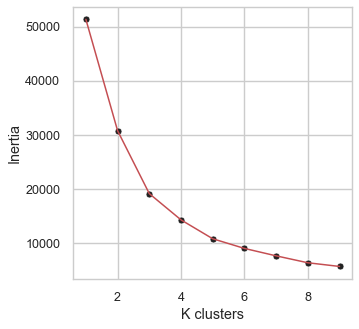

In [32]:
plt.figure(figsize = (5,5))
ks = list(range(1,10))
inertias = []

for ii in ks:
    model = KMeans(n_clusters=ii)
    model.fit(UMAP_components.iloc[:,:2])
    inertias.append(model.inertia_)

sns.scatterplot(x = ks, y = inertias, color = 'k')
sns.lineplot(x = ks, y = inertias, color = 'r')
plt.xlabel('K clusters')
plt.ylabel('Inertia')

In [33]:
# as with PCA, treat as 3-cluster data
kmeans_cluster = KMeans(n_clusters=3, random_state=123, n_jobs=-1, max_iter=1000)
%timeit kmeans_cluster.fit(UMAP_components)
y_pred = kmeans_cluster.predict(UMAP_components)

61.3 ms ± 6 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [34]:
silhouette_umap_kmeans = silhouette_score(UMAP_components, y_pred, metric = 'euclidean')
ari_umap_kmeans = adjusted_rand_score(y_umap, y_pred)
print('Silhouette Score (PCA/Kmeans) = {}'.format(silhouette_umap_kmeans))
print('Adjusted Rand Index (UMAP/Kmeans) = {}'.format(ari_umap_kmeans))

Silhouette Score (PCA/Kmeans) = 0.3877086043357849
Adjusted Rand Index (UMAP/Kmeans) = 0.06518512949315737


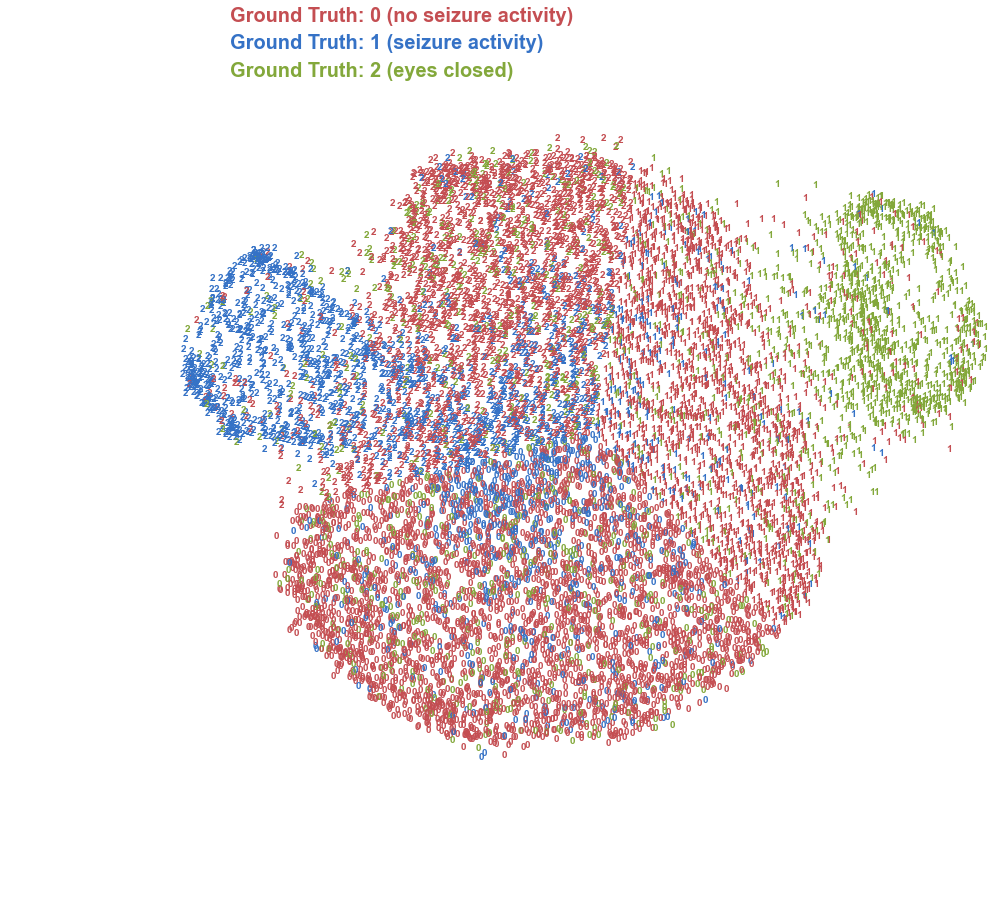

In [35]:
gt_plotter_umap(umap_results, y_pred, y_umap)

The k-means algorithm has done a reasonably good job at identifying the satellite clusters corresponding to classes 1 and 2, albeit with some some significant misassignment of class 0. In addition, class 2 has been assigned to the seizure condition (class 1) and class 1 has been assigned to the class 2 (eyes closed condition). K-means algorithm in scikit-learn provides a way to initialize centroid parameters. So let's replot the data with axes and estimate the three initial centroid positions/.  

Text(0, 0.5, 'Principal Component 2')

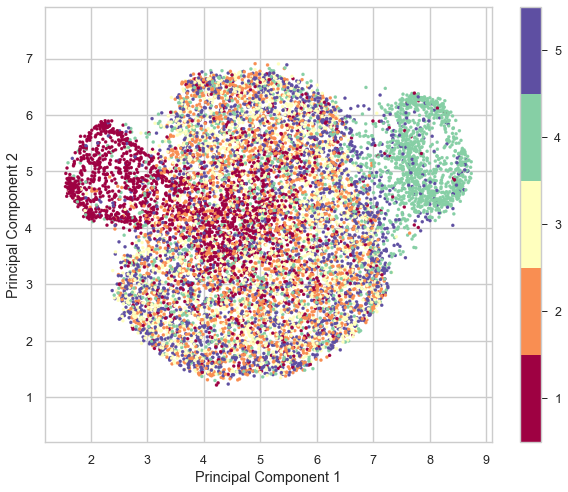

In [36]:
plt.figure(figsize=(10,8))
plt.scatter(umap_results[:,0], umap_results[:,1], c = y, cmap = 'Spectral', s = 10)
plt.gca().set_aspect('equal', 'datalim')
plt.colorbar(boundaries=np.arange(1,y.nunique()+2)-0.5).set_ticks(np.arange(10))
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')

In [37]:
inits = np.array([[5,4],
                  [2.5,5],
                  [8,5.5]], np.float64)

kmeans_cluster = KMeans(n_clusters=3, random_state=123, n_jobs=-1, n_init=1, init = inits, algorithm = 'elkan')
%timeit kmeans_cluster.fit(UMAP_components)
y_pred = kmeans_cluster.predict(UMAP_components)

21.6 ms ± 631 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [38]:
silhouette_umap_kmeans = silhouette_score(UMAP_components, y_pred, metric = 'euclidean')
ari_umap_kmeans = adjusted_rand_score(y_umap, y_pred)
print('Silhouette Score (PCA/Kmeans) = {}'.format(silhouette_umap_kmeans))
print('Adjusted Rand Index (UMAP/Kmeans) = {}'.format(ari_umap_kmeans))

Silhouette Score (PCA/Kmeans) = 0.38764631748199463
Adjusted Rand Index (UMAP/Kmeans) = 0.0662839537077939


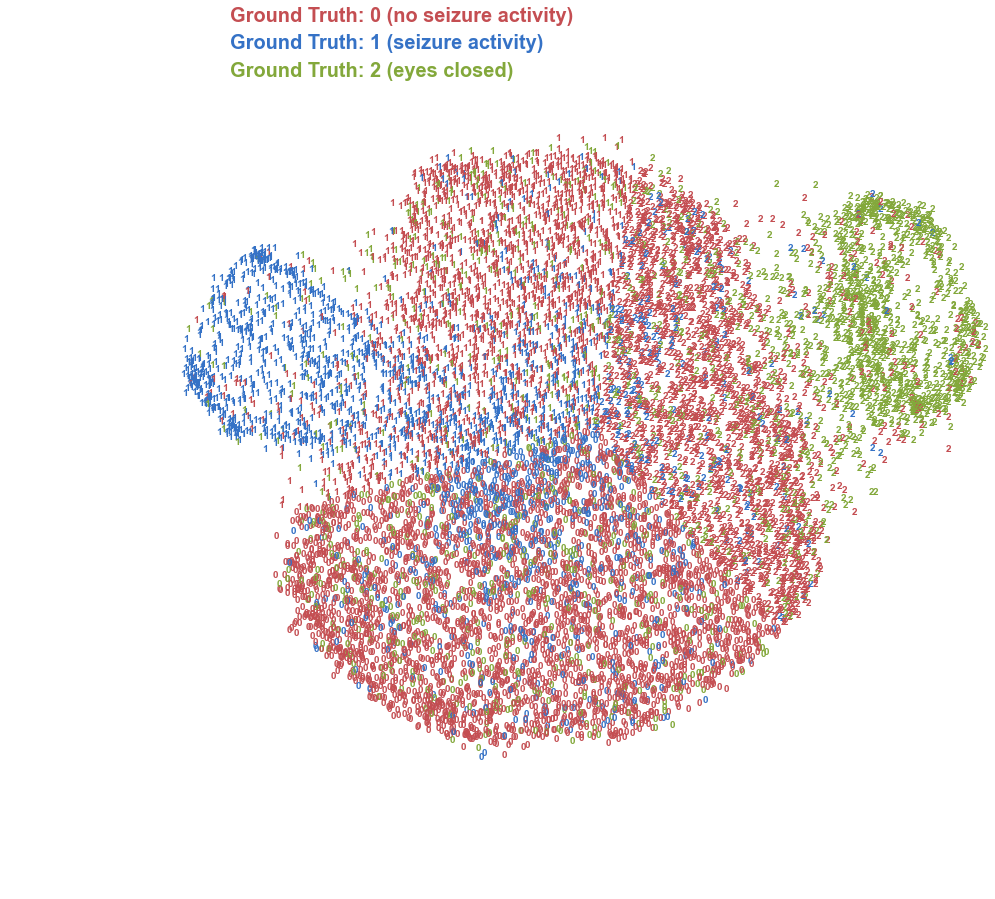

In [39]:
gt_plotter_umap(umap_results, y_pred, y_umap)

***
### Hierarchical Agglomerative Clustering (UMAP)

In [40]:
linkage_lst = ['ward', 'complete', 'average', 'single']
for ii in linkage_lst:
    print('*'*10 + ' Linkage = {} '.format(ii) +10*'*')
    agg_cluster = AgglomerativeClustering(linkage = ii, affinity = 'euclidean', n_clusters = 3)
    clusters = agg_cluster.fit_predict(umap_results)
    tmp_ss = silhouette_score(umap_results, clusters, metric = 'euclidean')
    tmp_ar = adjusted_rand_score(y_umap, clusters)
    print('Silhouette Score     = {}'.format(tmp_ss))
    print('Adjusted Rand Index  = {}'.format(tmp_ar))

********** Linkage = ward **********
Silhouette Score     = 0.34997236728668213
Adjusted Rand Index  = 0.10966725381200881
********** Linkage = complete **********
Silhouette Score     = 0.34295693039894104
Adjusted Rand Index  = 0.08871104645669048
********** Linkage = average **********
Silhouette Score     = 0.36501994729042053
Adjusted Rand Index  = 0.09903584311901432
********** Linkage = single **********
Silhouette Score     = 0.037636592984199524
Adjusted Rand Index  = 4.966938369622909e-05


In [41]:
agg_cluster = AgglomerativeClustering(linkage ='ward', affinity = 'euclidean', n_clusters = 3)
clusters = agg_cluster.fit_predict(umap_results)

This algorithm, unlike K-means, does not allow for centroid initialization. Previous visualization of the color-coded string labeled plot showed misassignment of classes 1 and 2 (data not shown) so we will go ahead and rearrange the labels below. The silhouette and adjusted Rand scores remain identical.

In [42]:
clusters_rearr = list(np.zeros(clusters.shape[0]))
for ii, jj in enumerate(clusters):
    if jj == 1:
        clusters_rearr[ii] = 2
    elif jj == 2:
        clusters_rearr[ii] = 1
    else:
        clusters_rearr[ii] = 0

In [43]:
silhouette_umap_hac = silhouette_score(umap_results, clusters_rearr, metric = 'euclidean')
ari_umap_hac = adjusted_rand_score(y_umap, clusters_rearr)
print('Silhouette Score (PCA/Hierachical)    = {}'.format(silhouette_umap_hac))
print('Adjusted Rand Index (PCA/Hierachical) = {}'.format(ari_umap_hac))

Silhouette Score (PCA/Hierachical)    = 0.34997236728668213
Adjusted Rand Index (PCA/Hierachical) = 0.10966725381200881


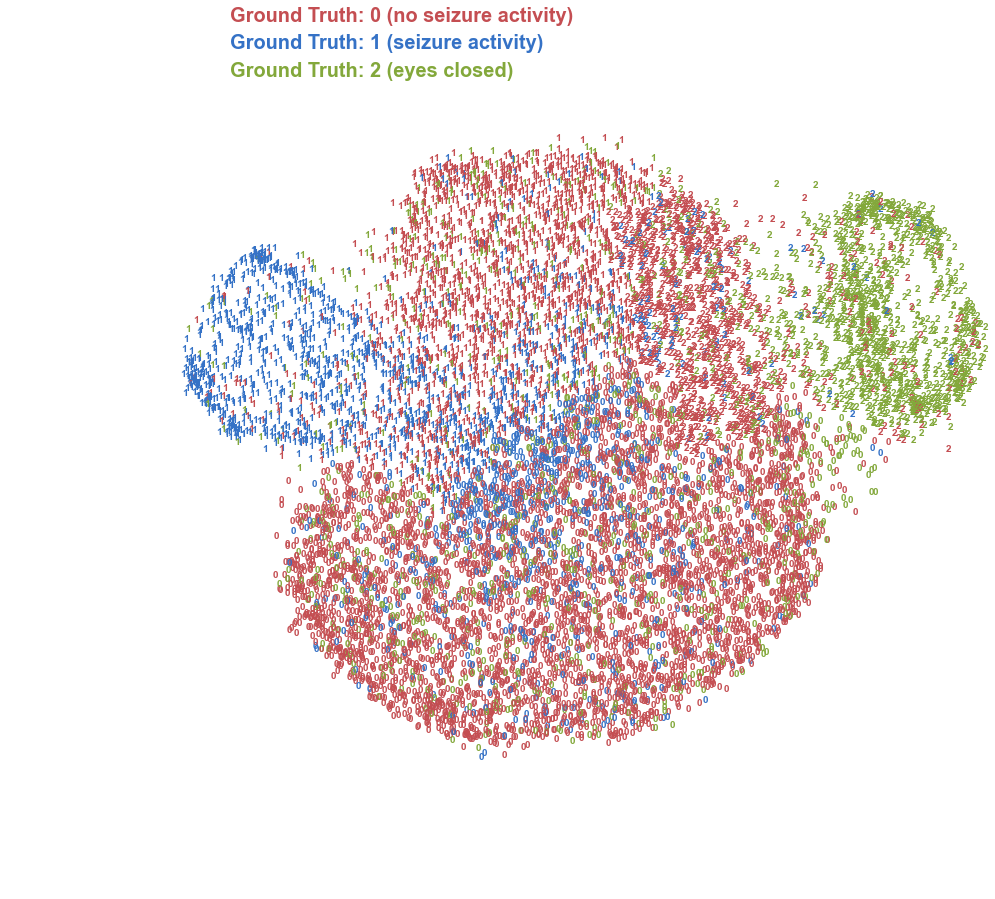

In [44]:
gt_plotter_umap(umap_results, clusters_rearr, y_umap)

***
### Gaussian Mixture Model

In [45]:
#gmm_cluster = GaussianMixture(n_components = 3, random_state = 123, max_iter = 10000, init_params = 'random', covariance_type = 'full', n_init = 10000)
gmm_cluster = GaussianMixture(n_components = 3, random_state = 123, max_iter = 1000, covariance_type = 'diag', n_init = 1000)
clusters = gmm_cluster.fit_predict(umap_results)

In [46]:
silhouette_umap_gmm = silhouette_score(umap_results, clusters, metric = 'euclidean')
ari_umap_gmm = adjusted_rand_score(y_umap, clusters)
print('Silhouette Score (UMAP/GMM) = {}'.format(silhouette_umap_gmm))
print('Adjusted Rand Index (UMAP/GMM) = {}'.format(ari_umap_gmm))

Silhouette Score (UMAP/GMM) = 0.37890732288360596
Adjusted Rand Index (UMAP/GMM) = 0.0883683093409754


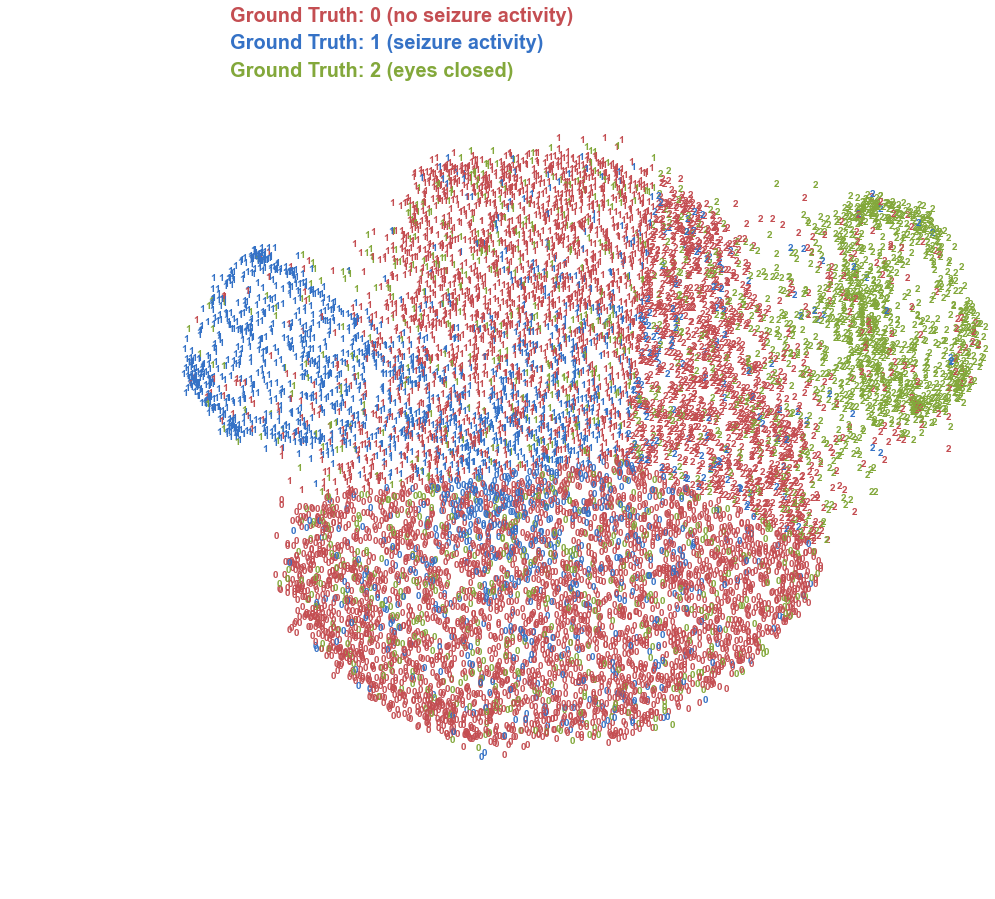

In [47]:
gt_plotter_umap(umap_results, clusters, y_umap)

***
## Summary
***

First, we will print the silhouette scores for all combinations of data reduction and clustering approaches.

In [48]:
print('Silhouette and ARI Scores Summary:\n')
print('Silhouette, ARI Score (PCA + K-Means):\t\t{:.3f}, {:.3f}'.format(silhouette_pca_kmeans, ari_pca_kmeans))
print('Silhouette, ARI Score (PCA + Hierarchical):\t{:.3f}, {:.3f}'.format(silhouette_pca_hac, ari_pca_hac))
print('Silhouette, ARI Score (PCA + GMM):\t\t{:.3f}, {:.3f}\n'.format(silhouette_pca_gmm, ari_pca_gmm))

print('Silhouette, ARI Score (UMAP + K-Means):\t\t{:.3f}, {:.3f}'.format(silhouette_umap_kmeans, ari_umap_kmeans))
print('Silhouette, ARI Score (UMAP + Hierarchical):\t{:.3f}, {:.3f}'.format(silhouette_umap_hac, ari_umap_hac))
print('Silhouette, ARI Score (UMAP + GMM):\t\t{:.3f}, {:.3f}'.format(silhouette_umap_gmm, ari_umap_gmm))

Silhouette and ARI Scores Summary:

Silhouette, ARI Score (PCA + K-Means):		0.612, 0.223
Silhouette, ARI Score (PCA + Hierarchical):	0.746, 0.214
Silhouette, ARI Score (PCA + GMM):		0.638, 0.744

Silhouette, ARI Score (UMAP + K-Means):		0.388, 0.066
Silhouette, ARI Score (UMAP + Hierarchical):	0.350, 0.110
Silhouette, ARI Score (UMAP + GMM):		0.379, 0.088


### PCA-reduced Data

Application of PCA to the current dataset effectively dispersed the seizure class (category 1) from all other classes. The 2D visualization revealed a distinct spread of seizure class data points that surrounded a central core comprised of all other classes. Given this appearance, the PCA-reduced data was treated as a two-class system and three different clustering techniques subsequently were applied in an effort to differentiate the seizure class (assigned as category 1) from all other classes. Of these three clustering methods, the Gaussian mixture model clearly out-performed all other approaches yielding silhouette and adjusted Rand scores of 0.64 and 0.74, respectively. Replotting the PCA-reduced data using string labels in combination with color-coded groud truths provided a visual confirmation of efficient assignment to the correct labels. 

### UMAP-reduced Data

In contrast to PCA, UMAP allows for tuning of several parameters that can help optimize the data reduction (https://umap-learn.readthedocs.io/en/latest/api.html). These include, but not limited to, the metric, n_neighbors, and min_dist parameters. A degree of effort was applied to opitmizing these three parameters. Although most combinations showed a tendency for separating the seizure class and eyes closed class from the remaining three classes. The parameter set of metric = 'correlation', min_dist = 0.1, and n_neighbors = 150 was selected as 2D visualization of the UMAP-reduced data revealed an effective separation **and** polarization of the seizure class from the eyes closed class. It was anticipated that this polarization would be beneficial enhancing preformance of subsequent clustering methods.</br>

Given the visualization of three clusters, the UMAP-reduced data was treated as a three-class system (1 - seizure, 2 - eyes closes, 0 - all remaining classes), and three different clustering techniques subsequently were applied. Hierarchical (agglomerative) clustering and the Gaussian mixture model showed comparable performance, although the former showed a slightly improved adjusted Rand index of 0.11 versus 0.09.

### Interpretation

What characterstics within the data might be present to differentiate the seizure condition from all other classes within the PCA-reduced data? It is expected that compared to all other conditions, the EEGs recorded during seizure activity would show largest fluctuations and variance in electrical signal activity. But what features are present within the data to help further differentiate the eyes closed condition from seizure activity and all other classes? Let's visualize some individual EEG recordings (1 second traces) for a few subject recordings for all five conditions.

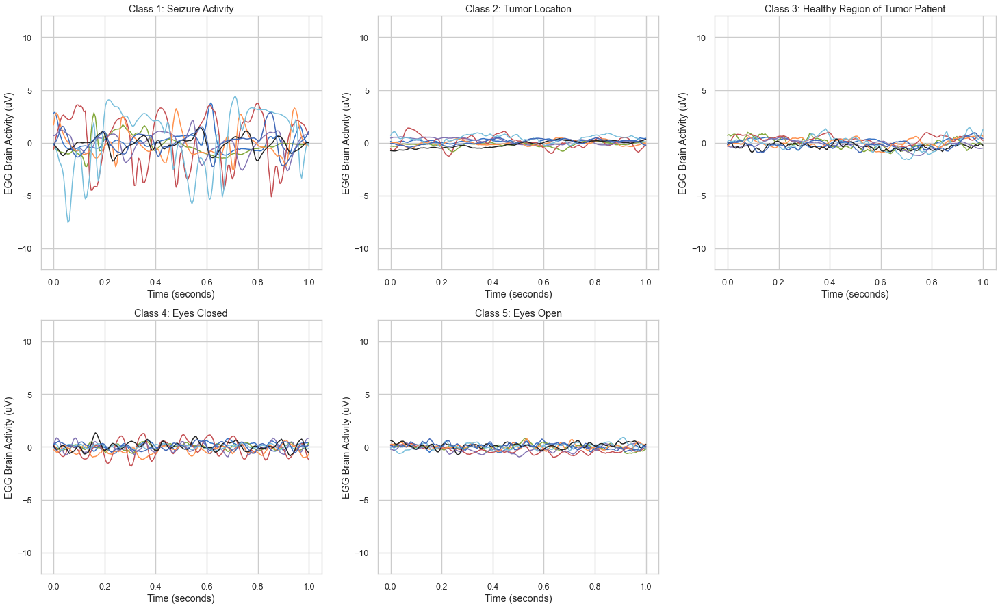

In [49]:
y_1 = np.where(y == 1)[0]
y_2 = np.where(y == 2)[0]
y_3 = np.where(y == 3)[0]
y_4 = np.where(y == 4)[0]
y_5 = np.where(y == 5)[0]
t   = np.linspace(0,1,df.shape[1])

def egg_plotter(data, index_array, subplot, title):
    plt.subplot(2,3,subplot)
    plt.plot(t, data.iloc[index_array[-8:],:].transpose());
    #plt.xticks([])
    plt.xlabel('Time (seconds)')
    plt.ylabel('EGG Brain Activity (uV)')
    plt.ylim([-12, 12])
    plt.title(title)

lst = [y_1, y_2, y_3, y_4, y_5]
classes = ['Class 1: Seizure Activity', 
           'Class 2: Tumor Location', 
           'Class 3: Healthy Region of Tumor Patient', 
           'Class 4: Eyes Closed', 
           'Class 5: Eyes Open']

plt.figure(figsize=(25,15))
for ii, jj in enumerate(lst):
    egg_plotter(df, lst[ii], ii+1, classes[ii])

Note that these EEG traces are all plotted using the same vertcal scaling. As expected the EEG recordings from seizure patients show large-amplitude fluctuations that undoubtedly add signifcantly to its differentiation in both the PCA- and UMAP-reduced data. Compared to classes 2, 3, and 5, the eye closed (class 4 above) EEG traces also show some low-amplitude periodic variation, which might also act to help its differentiation within the UMAP-reduced data.

### PCA versus UMAP

Clustering of the PCA-reduced data using GMM clearly offers the best performance and potential diagnostic utility, and with further development might be of significant interest to the field of seizure disorders. However, UMAP also should be further developed and evaluated as it holds great potential for automated classification of additional classes. The next section discusses possible future avenues for methods development.

### Future Directions

The work presented in this notebook is by no means conclusive. These findings offer a brief insight into the potential utility of data reduction algorithms and unsupervised learning approaches  as applied to EEG datasets. It should be noted that this notebook focused solely on time-domain data (i.e. electrical activity recorded over 1 second intervals). One possible approach might be to convert the data into the frequency domain via Fourier transformation. The resulting frequency-domain data might contain characteristics that enhance class differentiation following dimension reduction and clustering.</br>

Also, there exist many other options for data reduction and clustering algorithms that should be evaluated. These include Linear Discriminant Analysis (LDA) for data reduction and spectral clustering, desnity based spatial clustering for applications with noise (DBSCAN), and the mean-shift algorithm as alternatives for unsupervised clustering approaches. 